In [78]:
import mne, os
import pickle
import numpy as np 
import pandas as pd
import time

path = '/System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/'


# Specify the custom filename from which you want to load the pickle file
file_name = path + 'sub-S07_Dynamic_preprocessed-epo.fif'
file_name2 = path + 'sub-S07_Still_preprocessed-epo.fif'
#file_name2 = path + 'S13datamovieNoCatch-epo.fif'

# Use the pickle.load() method to load the 'Epochs' object from the custom filename

D_stacked = mne.read_epochs(file_name, preload=True)
S_stacked = mne.read_epochs(file_name2, preload=True)

#S13_stackedMovie = mne.read_epochs(file_name2, preload=True)


Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S07_Dynamic_preprocessed-epo.fif ...
    Found the data of interest:
        t =    -200.00 ...    3200.00 ms
        0 CTF compensation matrices available
Adding metadata with 8 columns
488 matching events found
No baseline correction applied
0 projection items activated
Reading /System/Volumes/Data/misc/data12/sjapee/Sebastian-OrientationImagery/Data/Bids/derivatives/preprocessed/sub-S07_Still_preprocessed-epo.fif ...
    Found the data of interest:
        t =    -200.00 ...     600.00 ms
        0 CTF compensation matrices available
Adding metadata with 8 columns
1056 matching events found
No baseline correction applied
0 projection items activated


In [79]:
epochs_stacked = S_stacked
epochs_stackedMovie = D_stacked

In [30]:
#Should I do this? Ask Lina

epochs_stackedMovie = D_stacked.drop(D_stacked['17'].selection)

Dropped 14 epochs: 7, 14, 21, 28, 35, 42, 49, 64, 71, 86, 94, 102, 110, 118


In [5]:
print(epochs_stackedMovie)

<EpochsFIF |  488 events (all good), -0.2 – 3.2 s, baseline -0.2 – 0 s, ~3.99 GB, data loaded, with metadata,
 '1': 28
 '2': 28
 '3': 28
 '4': 28
 '5': 28
 '6': 28
 '7': 28
 '8': 28
 '9': 28
 '10': 28
 and 7 more events ...>


In [9]:
print(epochs_stacked)

<EpochsFIF |  1104 events (all good), -0.2 – 0.6 s, baseline -0.2 – 0 s, ~2.13 GB, data loaded, with metadata,
 '1': 60
 '2': 60
 '3': 60
 '4': 60
 '5': 60
 '6': 60
 '7': 60
 '8': 60
 '9': 60
 '10': 60
 and 7 more events ...>


In [113]:
epochs_stacked = S_stacked.drop(S_stacked['17'].selection)

Dropped 92 epochs: 7, 13, 20, 27, 33, 40, 47, 54, 61, 68, 75, 83, 90, 97, 105, 113, 120, 128, 136, 151, 159, 167, 175, 190, 196, 203, 210, 216, 223, 230, 237, 244, 251, 258, 266, 273, 280, 288, 296, 303, 311, 319, 334, 342, 350, 358, 373, 379, 386, 393, 399, 406, 413, 420, 427, 434, 441, 449, 456, 463, 471, 479, 486, 494, 502, 517, 525, 533, 541, 556, 562, 569, 576, 582, 589, 596, 603, 610, 617, 624, 632, 639, 646, 654, 662, 669, 677, 685, 700, 708, 716, 724


In [4]:
#print(event_id)
#print(epochs_stacked.metadata)
#print(epochs_stacked.metadata['condition'])

{1: 'S01/Still/0001', 2: 'S01/Still/0022', 3: 'S01/Still/0045', 4: 'S01/Still/0067', 5: 'S01/Still/0090', 6: 'S01/Still/0122', 7: 'S01/Still/0135', 8: 'S01/Still/0157', 9: 'S01/Still/0180', 10: 'S01/Still/0202', 11: 'S01/Still/0225', 12: 'S01/Still/0247', 13: 'S01/Still/0270', 14: 'S01/Still/0292', 15: 'S01/Still/0315', 16: 'S01/Still/0337', 17: 'S01/Still/catch'}


In [10]:
print(epochs_stackedMovie.metadata)

          onset  duration              trial_type  value  sample  run_nr  \
0      6.344167       0.0  S01/Dynamic/0337_Right     16    7613       0   
1      9.877500       0.0   S01/Dynamic/0337_Left     15   11853       0   
2     13.460000       0.0  S01/Dynamic/0202_Right     10   16152       0   
3     17.010000       0.0   S01/Dynamic/0202_Left      9   20412       0   
4     20.526667       0.0   S01/Dynamic/0157_Left      7   24632       0   
..          ...       ...                     ...    ...     ...     ...   
483  431.665833       0.0  S01/Dynamic/0112_Right      6  517999       3   
484  435.215833       0.0  S01/Dynamic/0022_Right      2  522259       3   
485  438.781667       0.0   S01/Dynamic/0292_Left     13  526538       3   
486  442.331667       0.0  S01/Dynamic/0202_Right     10  530798       3   
487  445.865000       0.0   S01/Dynamic/0202_Left      9  535038       3   

    block_type   condition  
0      Dynamic  0337_Right  
1      Dynamic   0337_Left  


In [33]:
# Check if 'condition' column exists
if 'condition' in epochs_stackedMovie.metadata.columns:
    # Replace all '122' with '112' in the 'condition' column
    epochs_stackedMovie.metadata['condition'] = epochs_stackedMovie.metadata['condition'].replace('0122_Left', '0112_Left')
    epochs_stackedMovie.metadata['condition'] = epochs_stackedMovie.metadata['condition'].replace('0122_Right', '0112_Right')
else:
    print("'condition' column not found in metadata")


In [11]:
print(epochs_stackedMovie.metadata)

          onset  duration              trial_type  value  sample  run_nr  \
0      6.344167       0.0  S01/Dynamic/0337_Right     16    7613       0   
1      9.877500       0.0   S01/Dynamic/0337_Left     15   11853       0   
2     13.460000       0.0  S01/Dynamic/0202_Right     10   16152       0   
3     17.010000       0.0   S01/Dynamic/0202_Left      9   20412       0   
4     20.526667       0.0   S01/Dynamic/0157_Left      7   24632       0   
..          ...       ...                     ...    ...     ...     ...   
483  431.665833       0.0  S01/Dynamic/0112_Right      6  517999       3   
484  435.215833       0.0  S01/Dynamic/0022_Right      2  522259       3   
485  438.781667       0.0   S01/Dynamic/0292_Left     13  526538       3   
486  442.331667       0.0  S01/Dynamic/0202_Right     10  530798       3   
487  445.865000       0.0   S01/Dynamic/0202_Left      9  535038       3   

    block_type   condition  
0      Dynamic  0337_Right  
1      Dynamic   0337_Left  


loop: 51.23406910896301


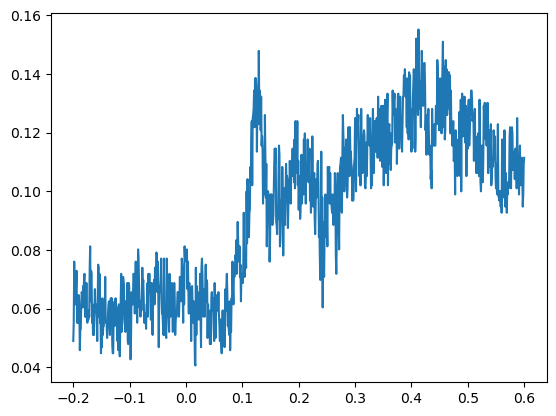

In [80]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn import svm
from joblib import Parallel, delayed
import matplotlib.pyplot as plt

def select_conditions(epochs_stacked,column_name,items_to_select):
    if type(items_to_select)==list:
        selected_epochs = epochs_stacked[np.any([epochs_stacked.metadata[column_name] == i  for i in items_to_select],axis=0)]
    if type(items_to_select)==str:
        selected_epochs = epochs_stacked[epochs_stacked.metadata[column_name] == items_to_select]
    return selected_epochs

def train_test_split(epo_stacked,test_run):
    epochs_test=epo_stacked[f'run_nr == {test_run}']
    y_test = epochs_test.metadata['condition'].to_numpy()
    x_test = epochs_test._data

    epochs_train=epo_stacked[f'run_nr != {test_run}']
    y_train = epochs_train.metadata['condition'].to_numpy()
    x_train = epochs_train._data

    return x_train, x_test, y_train, y_test

def run_decoding(x_train,y_train,x_test,y_test):
    pipe = Pipeline([('scaler', StandardScaler()), 
            ('classifier', svm.SVC(kernel='linear',C=1))])
    pipe.fit(x_train,y_train)
    predictions = pipe.predict(x_test)
    accuracy = predictions == y_test

    return np.mean(accuracy)

def run_timeseries_decoding(epochs_selected,test_run):
    x_train, x_test, y_train, y_test = train_test_split(epochs_selected,test_run)
    cv_res = Parallel(n_jobs=48, prefer="threads")(delayed(run_decoding)(x_train[:,:,t],y_train,x_test[:,:,t],y_test) for t in range(len(epochs_selected.times)))
    return cv_res


## WITHIN DECODING: simple timeseries
# THIS IS TOO SLOW
# program_starts = time.time()
# epochs_selected = select_conditions(epochs_stacked,column_name='block_type',items_to_select='Watch_Still')
# res = Parallel(n_jobs=48, prefer="threads")(delayed(run_timeseries_decoding)(select_conditions(epochs_stacked,column_name='block_type',items_to_select='Watch_Still'), test_run) for test_run in np.unique(epochs_selected.metadata.run_nr))
# time_series_results = np.mean(np.array(res),axis=0)
# print("parallel: {0}".format(time.time() - program_starts))


#Write a code with dictionary specifying all condition types I care about 
#Or pandas data file with each condition & accuracies
program_starts = time.time()
accuracy = []
epochs_selected = select_conditions(epochs_stacked,column_name='block_type',items_to_select='Still')
epochs_selected = select_conditions(epochs_stacked,column_name='condition',items_to_select=['0001', '0022', '0045', '0067', '0090', '0112', 
                        '0135', '0157', '0180', '0202', '0225', '0247',
                        '0270', '0292', '0315', '0337'])
#epochs_selected = select_conditions(epochs_stackedMovie,column_name='condition',items_to_select=['0122_Left', '0122_Right'])
for test_run in np.unique(epochs_selected.metadata.run_nr):
    x_train, x_test, y_train, y_test = train_test_split(epochs_selected,test_run)
    accuracy.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding)(x_train[:,:,t],y_train,x_test[:,:,t],y_test) for t in range(len(epochs_stacked.times))))
print("loop: {0}".format(time.time() - program_starts))
plt.plot(epochs_stacked.times, np.mean(np.array(accuracy),axis=0))


## WITHIN DECODING: time-generalization
epochs_selected = select_conditions(epochs_stacked,column_name='block_type',items_to_select='Still')

def run_timegen(epochs_selected,test_run):
    results_matrix = np.zeros((len(epochs_selected.times), len(epochs_selected.times)))
    x_train, x_test, y_train, y_test = train_test_split(epochs_selected,test_run)
    for training_tp in range(len(epochs_selected.times)):
        res = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding)(x_train[:,:,training_tp],y_train,x_test[:,:,t],y_test) for t in range(len(epochs_selected.times)))
        results_matrix[training_tp,:] = res
    return results_matrix

# accuracy = []
# for test_run in np.unique(epochs_selected.metadata.run_nr):
#     accuracy.append(run_timegen(epochs_selected,test_run))
# time_gen_results = np.mean(np.array(accuracy),axis=0)
# plt.plot(time_gen_results)


In [81]:
epochs_selected = select_conditions(epochs_stacked,column_name='condition',items_to_select=['0001', '0045', '0090', '0135',
                                                                                            '0180', '0225', '0270', '0315'])
epochs_selected = select_conditions(epochs_stacked,column_name='condition',items_to_select=['0001', '0022', '0045', '0067', '0090', '0112', 
                        '0135', '0157', '0180', '0202', '0225', '0247',
                        '0270', '0292', '0315', '0337'])

In [82]:
epochs_selectedMovie = select_conditions(epochs_stackedMovie,column_name='condition',items_to_select=['0022_Left', '0022_Right', '0067_Left', '0067_Right', '0112_Left', '0112_Right', 
                        '0157_Left', '0157_Right', '0202_Left', '0202_Right', '0247_Left', '0247_Right',
                        '0292_Left', '0292_Right', '0337_Left', '0337_Right'])


In [6]:
print(epochs_selectedMovie)

<EpochsFIF |  448 events (all good), -0.2 – 3.2 s, baseline -0.2 – 0 s, ~3.66 GB, data loaded, with metadata,
 '1': 28
 '2': 28
 '3': 28
 '4': 28
 '5': 28
 '6': 28
 '7': 28
 '8': 28
 '9': 28
 '10': 28
 and 6 more events ...>


In [7]:
print(epochs_selected)

<EpochsFIF |  960 events (all good), -0.2 – 0.6 s, baseline -0.2 – 0 s, ~1.85 GB, data loaded, with metadata,
 '1': 60
 '2': 60
 '3': 60
 '4': 60
 '5': 60
 '6': 60
 '7': 60
 '8': 60
 '9': 60
 '10': 60
 and 6 more events ...>


In [83]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn import svm
from joblib import Parallel, delayed
import matplotlib.pyplot as plt


#Average across or pick time points and then test for each time point 
specifyTime = True

def select_conditions(epochs_stacked,column_name,items_to_select):
    if type(items_to_select)==list:
        selected_epochs = epochs_stacked[np.any([epochs_stacked.metadata[column_name] == i  for i in items_to_select],axis=0)]
    if type(items_to_select)==str:
        selected_epochs = epochs_stacked[epochs_stacked.metadata[column_name] == items_to_select]
    return selected_epochs

def train_test_split_cross(epo_stacked, epo_stackedMovie, test_condition, start_time, end_time):
    epochs_test=epo_stackedMovie[epo_stackedMovie.metadata['condition'] == test_condition]
    y_test = epochs_test.metadata['condition'].to_numpy()
    x_test = epochs_test._data
    #x_test = x_test[100:500:]
    x_test.shape
    epochs_train=epo_stacked[epo_stacked.metadata['block_type'] == 'Still']
    y_train = epochs_train.metadata['condition'].to_numpy()
    mask = (epochs_train.times >= start_time) & (epochs_train.times <= end_time)


    if specifyTime == True:
        mask = (epochs_train.times >= start_time) & (epochs_train.times <= end_time)
        x_train = np.mean(epochs_train._data[:,:,mask], axis = 2)

    else:
        x_train = epochs_train._data
    return x_train, x_test, y_train, y_test

def run_decoding_cross(x_train,y_train,x_test):
    pipe = Pipeline([('scaler', StandardScaler()), 
            ('classifier', svm.SVC(kernel='linear',C=1))])
    pipe.fit(x_train,y_train)
    #Step where I average at each sensor weight, would need to loop around fit for each time point
    #And then I would let it return the weight matrix, and apply an average of the weights to the testing data
    predictions = pipe.predict(x_test)
    return predictions

In [84]:
def find_contacting_movies_and_samples(input_number, movies):
    def normalize_frame(frame):
        """Normalize frame to be within 0 to 359."""
        return frame % 360

    def frames_contact(movie_start, input_number):
        """Check if a movie intersects the input number."""
        right_frames = [(movie_start + i) % 360 for i in range(181)]
        left_frames = [(movie_start - i) % 360 for i in range(181)]
        left_frames = [normalize_frame(f) for f in left_frames]

        return input_number in right_frames, input_number in left_frames

    def calculate_sample_time(movie_start, input_number, direction):
        """Calculate the sample time at which the movie passes through the input number."""
        if direction == "Right":
            frame_difference = (input_number - movie_start) % 360
        else:  # direction == "Left"
            frame_difference = (movie_start - input_number) % 360
        
        if frame_difference == 0:
            return 0
        else:
            return 16 + frame_difference * 20

    result = {}
    for movie_start in movies:
        right_contacts, left_contacts = frames_contact(movie_start, input_number)
        
        if right_contacts:
            if movie_start < 100: #Ensure correct naming, movies less than 100 have two zeros in front of them in condition name
                movie_name = f"00{movie_start}_Right"
            else:
                movie_name = f"0{movie_start}_Right"
            sample_time = calculate_sample_time(movie_start, input_number, "Right") + 240
            result[movie_name] = sample_time
        
        if left_contacts:
            if movie_start < 100:
                movie_name = f"00{movie_start}_Left"
            else:
                movie_name = f"0{movie_start}_Left"
            sample_time = calculate_sample_time(movie_start, input_number, "Left") + 240
            result[movie_name] = sample_time

    return result

#input_number = [0, 22, 45, 67, 90, 122, 135, 157, 180, 202, 225, 247, 270, 292, 315, 337] #List of still frames movies can contact
input_number = [0, 45, 90, 135, 180, 225, 270, 315] #List of frames you want to find the timepoint at which the movie passes through
input_number = [0, 22, 45, 67, 90, 112, 135, 157, 180, 202, 225, 247, 270, 292, 315, 337]
movies = [22, 67, 112, 157, 202, 247, 292, 337]  # List of starting frames for movies
result_list = []

#For every frame you want to find that the movie passes through, create a dictionary that has a key value mapping of movie: time point in samples that the movie passes through that frame
#The order of result list corresponds to the order of input_number
for i in input_number:
    result_list.append(find_contacting_movies_and_samples(i, movies))


In [92]:
for d in result_list:
    keys_to_remove = [key for key, value in d.items() if value == 240 or value > 3800]
    for key in keys_to_remove:
        d.pop(key)

print(result_list)

[{'0022_Left': 696, '0067_Left': 1596, '0112_Left': 2496, '0157_Left': 3396, '0202_Right': 3416, '0247_Right': 2516, '0292_Right': 1616, '0337_Right': 716}, {'0067_Left': 1156, '0112_Left': 2056, '0157_Left': 2956, '0247_Right': 2956, '0292_Right': 2056, '0337_Right': 1156}, {'0022_Right': 716, '0067_Left': 696, '0112_Left': 1596, '0157_Left': 2496, '0202_Left': 3396, '0247_Right': 3416, '0292_Right': 2516, '0337_Right': 1616}, {'0022_Right': 1156, '0112_Left': 1156, '0157_Left': 2056, '0202_Left': 2956, '0292_Right': 2956, '0337_Right': 2056}, {'0022_Right': 1616, '0067_Right': 716, '0112_Left': 696, '0157_Left': 1596, '0202_Left': 2496, '0247_Left': 3396, '0292_Right': 3416, '0337_Right': 2516}, {'0022_Right': 2056, '0067_Right': 1156, '0157_Left': 1156, '0202_Left': 2056, '0247_Left': 2956, '0337_Right': 2956}, {'0022_Right': 2516, '0067_Right': 1616, '0112_Right': 716, '0157_Left': 696, '0202_Left': 1596, '0247_Left': 2496, '0292_Left': 3396, '0337_Right': 3416}, {'0022_Right': 295

In [85]:
for d in result_list:
    keys_to_remove = [key for key, value in d.items() if value == 240]
    for key in keys_to_remove:
        d.pop(key)

print(result_list)

[{'0022_Left': 696, '0067_Left': 1596, '0112_Left': 2496, '0157_Left': 3396, '0202_Right': 3416, '0247_Right': 2516, '0292_Right': 1616, '0337_Right': 716}, {'0067_Left': 1156, '0112_Left': 2056, '0157_Left': 2956, '0202_Right': 3856, '0202_Left': 3856, '0247_Right': 2956, '0292_Right': 2056, '0337_Right': 1156}, {'0022_Right': 716, '0067_Left': 696, '0112_Left': 1596, '0157_Left': 2496, '0202_Left': 3396, '0247_Right': 3416, '0292_Right': 2516, '0337_Right': 1616}, {'0022_Right': 1156, '0112_Left': 1156, '0157_Left': 2056, '0202_Left': 2956, '0247_Right': 3856, '0247_Left': 3856, '0292_Right': 2956, '0337_Right': 2056}, {'0022_Right': 1616, '0067_Right': 716, '0112_Left': 696, '0157_Left': 1596, '0202_Left': 2496, '0247_Left': 3396, '0292_Right': 3416, '0337_Right': 2516}, {'0022_Right': 2056, '0067_Right': 1156, '0157_Left': 1156, '0202_Left': 2056, '0247_Left': 2956, '0292_Right': 3856, '0292_Left': 3856, '0337_Right': 2956}, {'0022_Right': 2516, '0067_Right': 1616, '0112_Right': 71

In [11]:
print(result_list[2])

{'0022_Right': 716, '0067_Left': 696, '0112_Left': 1596, '0157_Left': 2496, '0202_Left': 3396, '0247_Right': 3416, '0292_Right': 2516, '0337_Right': 1616}


In [12]:
print(len(result_list))

16


In [86]:
###CREATE LISTS THAT REPRESENT STARTING POSITIONS FOR MOVIES RELATIVE TO TARGETS###
#Result_list would allow us to average across all movies and look at cross-decoding for a target, but only in a small time window (since when a given target appears in a movie differs)
#To average across movies and show further time points, we need to separate movies by when a given target appears in that movie
#The structure of these lists mirrors the structure of result list: each entry in the list corresponds to the input_number list, and each contains a dictionary mapping movies to time points
#So for instance in list 1, the first entry shows the movies that pass through the first entry in input number, the second entry the second entry, etc.
#The difference is now we are subselecting *movies for which the target appears only early on, in the middle, or later on -
#



list_1 = [] #Movies in which the target appears first in the movie
list_2 = [] #target appears second
list_3 = [] #target appears third
list_4 = [] #target appears fourth

# Loop through each entry (dictionary) in result_list
for original_dict in result_list:
    # Sort the dictionary items by their time values (ascending)
    sorted_items = sorted(original_dict.items(), key=lambda item: item[1])
    print(sorted_items)
    
    # Create new dictionaries based on the sorted values: since movies go in both directions,
    # there are two movies for each 'target position' one might want to decode 
    dict_1 = dict(sorted_items[:2])  # Lowest 2 time values
    dict_2 = dict(sorted_items[2:4])  # Second lowest 2 time values
    dict_3 = dict(sorted_items[4:6])  # Third lowest 2 time values
    dict_4 = dict(sorted_items[6:])   # Remaining time values
    
    # Append the new dictionaries to the respective lists
    list_1.append(dict_1)
    list_2.append(dict_2)
    list_3.append(dict_3)
    list_4.append(dict_4)

# Print the results for verification
print("List 1:", list_1)
print("List 2:", list_2)
print("List 3:", list_3)
print("List 4:", list_4)

[('0022_Left', 696), ('0337_Right', 716), ('0067_Left', 1596), ('0292_Right', 1616), ('0112_Left', 2496), ('0247_Right', 2516), ('0157_Left', 3396), ('0202_Right', 3416)]
[('0067_Left', 1156), ('0337_Right', 1156), ('0112_Left', 2056), ('0292_Right', 2056), ('0157_Left', 2956), ('0247_Right', 2956), ('0202_Right', 3856), ('0202_Left', 3856)]
[('0067_Left', 696), ('0022_Right', 716), ('0112_Left', 1596), ('0337_Right', 1616), ('0157_Left', 2496), ('0292_Right', 2516), ('0202_Left', 3396), ('0247_Right', 3416)]
[('0022_Right', 1156), ('0112_Left', 1156), ('0157_Left', 2056), ('0337_Right', 2056), ('0202_Left', 2956), ('0292_Right', 2956), ('0247_Right', 3856), ('0247_Left', 3856)]
[('0112_Left', 696), ('0067_Right', 716), ('0157_Left', 1596), ('0022_Right', 1616), ('0202_Left', 2496), ('0337_Right', 2516), ('0247_Left', 3396), ('0292_Right', 3416)]
[('0067_Right', 1156), ('0157_Left', 1156), ('0022_Right', 2056), ('0202_Left', 2056), ('0247_Left', 2956), ('0337_Right', 2956), ('0292_Righ

In [39]:
print(len(list_1))

16


In [87]:
# Lists to store results
even_left = []
even_right = []
odd = []
even = []

# Loop over list_1 with index
for idx, dictionary in enumerate(list_1):
    # Separate into even and odd entries
    if idx % 2 == 0:  # even indices
        even.append({k: v for k, v in dictionary.items()})
        even_left.append({k: v for k, v in dictionary.items() if k.endswith('_Left')})
        even_right.append({k: v for k, v in dictionary.items() if k.endswith('_Right')})
    else:  # odd indices
        odd.append({k: v for k, v in dictionary.items()})

# Resulting lists
print("Even Left:", even_left)
print("Even Right:", even_right)
print("Odd Left:", odd)
print("even", even)



Even Left: [{'0022_Left': 696}, {'0067_Left': 696}, {'0112_Left': 696}, {'0157_Left': 696}, {'0202_Left': 696}, {'0247_Left': 696}, {'0292_Left': 696}, {'0337_Left': 696}]
Even Right: [{'0337_Right': 716}, {'0022_Right': 716}, {'0067_Right': 716}, {'0112_Right': 716}, {'0157_Right': 716}, {'0202_Right': 716}, {'0247_Right': 716}, {'0292_Right': 716}]
Odd Left: [{'0067_Left': 1156, '0337_Right': 1156}, {'0022_Right': 1156, '0112_Left': 1156}, {'0067_Right': 1156, '0157_Left': 1156}, {'0112_Right': 1156, '0202_Left': 1156}, {'0157_Right': 1156, '0247_Left': 1156}, {'0202_Right': 1156, '0292_Left': 1156}, {'0247_Right': 1156, '0337_Left': 1156}, {'0022_Left': 1156, '0292_Right': 1156}]
even [{'0022_Left': 696, '0337_Right': 716}, {'0067_Left': 696, '0022_Right': 716}, {'0112_Left': 696, '0067_Right': 716}, {'0157_Left': 696, '0112_Right': 716}, {'0202_Left': 696, '0157_Right': 716}, {'0247_Left': 696, '0202_Right': 716}, {'0292_Left': 696, '0247_Right': 716}, {'0337_Left': 696, '0292_Righ

In [25]:
print(decoding_dictList2[1])

{'0067_Left': [array(['0112', '0090', '0135', '0045', '0112', '0067', '0112', '0112',
       '0157', '0292', '0225', '0067', '0001', '0112', '0112', '0067',
       '0157', '0001', '0067', '0045', '0225', '0135', '0292', '0292',
       '0090', '0090', '0135', '0090'], dtype=object), array(['0180', '0090', '0022', '0292', '0112', '0090', '0112', '0001',
       '0225', '0001', '0225', '0315', '0001', '0067', '0067', '0067',
       '0315', '0001', '0067', '0045', '0001', '0090', '0202', '0157',
       '0022', '0090', '0180', '0001'], dtype=object), array(['0001', '0090', '0022', '0001', '0202', '0090', '0112', '0090',
       '0202', '0202', '0270', '0157', '0067', '0225', '0090', '0001',
       '0067', '0001', '0045', '0045', '0001', '0090', '0202', '0157',
       '0022', '0292', '0067', '0001'], dtype=object), array(['0090', '0045', '0090', '0001', '0292', '0090', '0247', '0202',
       '0202', '0090', '0270', '0112', '0001', '0225', '0022', '0001',
       '0067', '0112', '0045', '0045', 

In [88]:
#Create a list where each entry again corresponds to result_list
#Each entry will contain dictionaries with the decoding predictions for that movie across the time window specified by start_Time and end_Time relative to the target position


decoding_dictList1 = []
#Loop through the list, each entry represents a target position we are looking at
for i in odd:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_selectedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 1156
        endTime = sample_time + 2700
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList1.append(decoding_dict)

movie is 0067_Left
epo time is 0 3856
movie is 0337_Right
epo time is 0 3856
movie is 0022_Right
epo time is 0 3856
movie is 0112_Left
epo time is 0 3856
movie is 0067_Right
epo time is 0 3856
movie is 0157_Left
epo time is 0 3856
movie is 0112_Right
epo time is 0 3856
movie is 0202_Left
epo time is 0 3856
movie is 0157_Right
epo time is 0 3856
movie is 0247_Left
epo time is 0 3856
movie is 0202_Right
epo time is 0 3856
movie is 0292_Left
epo time is 0 3856
movie is 0247_Right
epo time is 0 3856
movie is 0337_Left
epo time is 0 3856
movie is 0022_Left
epo time is 0 3856
movie is 0292_Right
epo time is 0 3856


In [44]:
print(len(decoding_dictList1))

16


In [89]:
#Create a list where each entry again corresponds to result_list
#Each entry will contain dictionaries with the decoding predictions for that movie across the time window specified by start_Time and end_Time relative to the target position


decoding_dictList2 = []
#Loop through the list, each entry represents a target position we are looking at
for i in even:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_selectedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 696
        endTime = sample_time + 2900
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList2.append(decoding_dict)

movie is 0022_Left
epo time is 0 3596
movie is 0337_Right
epo time is 20 3616
movie is 0067_Left
epo time is 0 3596
movie is 0022_Right
epo time is 20 3616
movie is 0112_Left
epo time is 0 3596
movie is 0067_Right
epo time is 20 3616
movie is 0157_Left
epo time is 0 3596
movie is 0112_Right
epo time is 20 3616
movie is 0202_Left
epo time is 0 3596
movie is 0157_Right
epo time is 20 3616
movie is 0247_Left
epo time is 0 3596
movie is 0202_Right
epo time is 20 3616
movie is 0292_Left
epo time is 0 3596
movie is 0247_Right
epo time is 20 3616
movie is 0337_Left
epo time is 0 3596
movie is 0292_Right
epo time is 20 3616


In [90]:
#Create a list where each entry again corresponds to result_list
#Each entry will contain dictionaries with the decoding predictions for that movie across the time window specified by start_Time and end_Time relative to the target position


decoding_dictList3 = []
#Loop through the list, each entry represents a target position we are looking at
for i in list_1:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_stackedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 696
        endTime = sample_time + 2700
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList3.append(decoding_dict)

movie is 0022_Left
epo time is 0 3396
movie is 0337_Right
epo time is 20 3416
movie is 0067_Left
epo time is 460 3856
movie is 0337_Right
epo time is 460 3856
movie is 0067_Left
epo time is 0 3396
movie is 0022_Right
epo time is 20 3416
movie is 0022_Right
epo time is 460 3856
movie is 0112_Left
epo time is 460 3856
movie is 0112_Left
epo time is 0 3396
movie is 0067_Right
epo time is 20 3416
movie is 0067_Right
epo time is 460 3856
movie is 0157_Left
epo time is 460 3856
movie is 0157_Left
epo time is 0 3396
movie is 0112_Right
epo time is 20 3416
movie is 0112_Right
epo time is 460 3856
movie is 0202_Left
epo time is 460 3856
movie is 0202_Left
epo time is 0 3396
movie is 0157_Right
epo time is 20 3416
movie is 0157_Right
epo time is 460 3856
movie is 0247_Left
epo time is 460 3856
movie is 0247_Left
epo time is 0 3396
movie is 0202_Right
epo time is 20 3416
movie is 0202_Right
epo time is 460 3856
movie is 0292_Left
epo time is 460 3856
movie is 0292_Left
epo time is 0 3396
movie is

In [22]:
print(len(decoding_dictList1))
print(len(decoding_dictList2))

8
24


In [31]:
decoding_dictList3 = decoding_dictList2[:8]
decoding_dictList4 =  decoding_dictList2[8:24]

In [33]:
print(len(decoding_dictList4))

16


In [50]:
decoding_dictList3 = []
#Loop through the list, each entry represents a target position we are looking at
for i in list_2:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_stackedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 1500
        endTime = sample_time + 2300
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList3.append(decoding_dict)

movie is 0067_Left
epo time is 96 3896
movie is 0292_Right
epo time is 116 3916
movie is 0112_Left
epo time is 96 3896
movie is 0337_Right
epo time is 116 3916
movie is 0157_Left
epo time is 96 3896
movie is 0022_Right
epo time is 116 3916
movie is 0202_Left
epo time is 96 3896
movie is 0067_Right
epo time is 116 3916
movie is 0247_Left
epo time is 96 3896
movie is 0112_Right
epo time is 116 3916
movie is 0292_Left
epo time is 96 3896
movie is 0157_Right
epo time is 116 3916
movie is 0337_Left
epo time is 96 3896
movie is 0202_Right
epo time is 116 3916
movie is 0022_Left
epo time is 96 3896
movie is 0247_Right
epo time is 116 3916


In [42]:
decoding_dictList4 = []
#Loop through the list, each entry represents a target position we are looking at
for i in list_3:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_stackedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 2300
        endTime = sample_time + 1500
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList4.append(decoding_dict)

movie is 0112_Left
epo time is 196 3996
movie is 0247_Right
epo time is 216 4016
movie is 0157_Left
epo time is 196 3996
movie is 0292_Right
epo time is 216 4016
movie is 0202_Left
epo time is 196 3996
movie is 0337_Right
epo time is 216 4016
movie is 0247_Left
epo time is 196 3996
movie is 0022_Right
epo time is 216 4016
movie is 0292_Left
epo time is 196 3996
movie is 0067_Right
epo time is 216 4016
movie is 0337_Left
epo time is 196 3996
movie is 0112_Right
epo time is 216 4016
movie is 0022_Left
epo time is 196 3996
movie is 0157_Right
epo time is 216 4016
movie is 0067_Left
epo time is 196 3996
movie is 0202_Right
epo time is 216 4016


In [43]:
decoding_dictList5 = []
#Loop through the list, each entry represents a target position we are looking at
for i in list_4:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_stackedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 3000
        endTime = sample_time + 600
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList5.append(decoding_dict)

movie is 0157_Left
epo time is 396 3996
movie is 0202_Right
epo time is 416 4016
movie is 0202_Left
epo time is 396 3996
movie is 0247_Right
epo time is 416 4016
movie is 0247_Left
epo time is 396 3996
movie is 0292_Right
epo time is 416 4016
movie is 0292_Left
epo time is 396 3996
movie is 0337_Right
epo time is 416 4016
movie is 0337_Left
epo time is 396 3996
movie is 0022_Right
epo time is 416 4016
movie is 0022_Left
epo time is 396 3996
movie is 0067_Right
epo time is 416 4016
movie is 0067_Left
epo time is 396 3996
movie is 0112_Right
epo time is 416 4016
movie is 0112_Left
epo time is 396 3996
movie is 0157_Right
epo time is 416 4016


In [94]:
decoding_dictList6 = []
#Loop through the list, each entry represents a target position we are looking at
for i in result_list:
    #create an empty dictionary to store the decoding results
    decoding_dict = {}

    #Fpr each movie (dictionary key) and the sample time at which that movie passes through a target, generate decoding value across a time window relative to that time point
    for movie, sample_time in i.items():
        #Training time in the still-trials is set here
        x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_selectedMovie, movie, .25, .35)

        #how far out we want the window in both directions is set here
        startTime = sample_time - 655
        endTime = sample_time + 655
        print('movie is', movie)
        print('epo time is', startTime, endTime)
        #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
        decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train[:],y_train[:],x_test[:,:,t]) for t in range(startTime, endTime))
        movie = movie
        decoding_dict[movie] = decoding_list
    #add the decoding dictionary overtime to the overall list
    decoding_dictList6.append(decoding_dict)

movie is 0022_Left
epo time is 41 1351
movie is 0067_Left
epo time is 941 2251
movie is 0112_Left
epo time is 1841 3151
movie is 0157_Left
epo time is 2741 4051
movie is 0202_Right
epo time is 2761 4071
movie is 0247_Right
epo time is 1861 3171
movie is 0292_Right
epo time is 961 2271
movie is 0337_Right
epo time is 61 1371
movie is 0067_Left
epo time is 501 1811
movie is 0112_Left
epo time is 1401 2711
movie is 0157_Left
epo time is 2301 3611
movie is 0247_Right
epo time is 2301 3611
movie is 0292_Right
epo time is 1401 2711
movie is 0337_Right
epo time is 501 1811
movie is 0022_Right
epo time is 61 1371
movie is 0067_Left
epo time is 41 1351
movie is 0112_Left
epo time is 941 2251
movie is 0157_Left
epo time is 1841 3151
movie is 0202_Left
epo time is 2741 4051
movie is 0247_Right
epo time is 2761 4071
movie is 0292_Right
epo time is 1861 3171
movie is 0337_Right
epo time is 961 2271
movie is 0022_Right
epo time is 501 1811
movie is 0112_Left
epo time is 501 1811
movie is 0157_Left
e

In [24]:
print(len(decoding_dictList6))

16


In [ ]:
print(decoding_dictList1[0])

In [170]:
print(decoding_dictList2[11].keys())

dict_keys(['0202_Right', '0292_Left'])


In [70]:
#This function remaps the labels inside of decoding dictionaries to make them relative to a target, so that it can be averaged across cross-decoding results
#Wherein the target condition differs and the stills that appeared before and after it differ
def circularDict(correctCond, direction):
    #We know that in circular space this is the order of arrangement for conditions
    circularSpace = ['0180', '0202', '0225', '0247', '0270', '0292', '0315', '0337', '0001', '0022', '0045', '0067', '0090', '0112', '0135', '0157']
    #Find where in the circular space the target condition is located
    index = circularSpace.index(correctCond)
    #create a new dictionary that will 
    new_dict = {}
    for i in range(len(circularSpace)):
        new_index = (index + i) % len(circularSpace)
        #If the movie is moving in opposite directions, what is before and after a target condition flips
        if direction == 'Left':
            label1 = 'after'
            label2 = 'before'
        else:
            label1 = 'before'
            label2 = 'after'
        distance = i
        if distance == 0:
            new_dict[circularSpace[new_index]] = 'target_cond'
        elif distance == 8:
            new_dict[circularSpace[new_index]] = 'opposite'
        elif distance < 8:
            new_dict[circularSpace[new_index]] = f'{distance}_{label2}'
        else:
            before_index = (index - (len(circularSpace) - i)) % len(circularSpace)
            if (len(circularSpace) - i) == 8:
                new_dict[circularSpace[before_index]] = 'opposite'
            else:
                new_dict[circularSpace[before_index]] = f'{len(circularSpace) - i}_{label1}'

    return new_dict

def remap_array(i, relabel_dict):
    return [relabel_dict.get(element, element) for element in i]

def relabelCond(decoding_list, relabel_dict):
    new_list = []
    for i in decoding_list:
        new_array = remap_array(i, relabel_dict)
        new_list.append(new_array)
    return new_list

#ordered_conditions = ['Center', '45_Right', 'Right', '135_Right', 'Back', '135_Left', 'Left', '45_Left']
ordered_conditions = ['0001', '0022', '0045', '0067', '0090', '0112', 
                        '0135', '0157', '0180', '0202', '0225', '0247',
                        '0270', '0292', '0315', '0337']

In [15]:
#This function remaps the labels inside of decoding dictionaries to make them relative to a target, so that it can be averaged across cross-decoding results
#Wherein the target condition differs and the stills that appeared before and after it differ
def circularDict(correctCond, direction):
    #We know that in circular space this is the order of arrangement for conditions
    circularSpace = ['0180', '0225', '0270', '0315', '0001', '0045', '0090', '0135']
    #Find where in the circular space the target condition is located
    index = circularSpace.index(correctCond)
    #create a new dictionary that will 
    new_dict = {}
    for i in range(len(circularSpace)):
        new_index = (index + i) % len(circularSpace)
        #If the movie is moving in opposite directions, what is before and after a target condition flips
        if direction == 'Left':
            label1 = 'after'
            label2 = 'before'
        else:
            label1 = 'before'
            label2 = 'after'
        distance = i
        if distance == 0:
            new_dict[circularSpace[new_index]] = 'target_cond'
        elif distance == 4:
            new_dict[circularSpace[new_index]] = 'opposite'
        elif distance < 4:
            new_dict[circularSpace[new_index]] = f'{distance}_{label2}'
        else:
            before_index = (index - (len(circularSpace) - i)) % len(circularSpace)
            if (len(circularSpace) - i) == 4:
                new_dict[circularSpace[before_index]] = 'opposite'
            else:
                new_dict[circularSpace[before_index]] = f'{len(circularSpace) - i}_{label1}'

    return new_dict

def remap_array(i, relabel_dict):
    return [relabel_dict.get(element, element) for element in i]

def relabelCond(decoding_list, relabel_dict):
    new_list = []
    for i in decoding_list:
        new_array = remap_array(i, relabel_dict)
        new_list.append(new_array)
    return new_list

#ordered_conditions = ['Center', '45_Right', 'Right', '135_Right', 'Back', '135_Left', 'Left', '45_Left']
ordered_conditions = ['0001', '0045', '0090', '0135', '0180', '0225', '0270', '0315']

In [98]:
odds = 1
evens = 0

if odds:
    ordered_conditions = ['0022', '0067', '0112', '0157', '0202', '0247', '0292', '0337']
elif evens:
    ordered_conditions = ['0001', '0045', '0090', '0135', '0180', '0225', '0270', '0315']
else:
    ordered_conditions = ['0001', '0022', '0045', '0067', '0090', '0112', 
                        '0135', '0157', '0180', '0202', '0225', '0247',
                        '0270', '0292', '0315', '0337']


decoding_dictList = decoding_dictList1
standardized_dictList = []
for index, condition in enumerate(ordered_conditions):
    print(condition)
    decoding_dict = decoding_dictList[index]
    standardized_dict = {}
    for movie, decoding_list in decoding_dict.items():
        underscore_pos = movie.find('_')
        direction = movie[underscore_pos + 1:]
        remap_dict = circularDict(condition, direction)
        new_list = relabelCond(decoding_list, remap_dict)
        standardized_dict[movie] = new_list
    standardized_dictList.append(standardized_dict)

0001
0022
0045
0067
0090
0112
0135
0157
0180
0202
0225
0247
0270
0292
0315
0337


In [41]:
print(standardized_dictList[0].keys())

dict_keys(['0067_Left', '0337_Right'])


In [43]:
print((standardized_dictList[0]['0022_Right'][0]))

KeyError: '0022_Right'

In [137]:
print(standardized_dictList[0])

{'0022_Left': [['1_after', '1_after', '3_after', 'target_cond', '5_after', '1_after', '6_before', '5_before', '1_before', '1_before', '1_before', '5_before', '5_before', 'target_cond', '4_after', '4_after', '3_after', '1_after', '3_before', '1_after', 'target_cond', 'target_cond', '2_before', 'catch', '2_after', '1_after', '5_after', 'target_cond'], ['2_after', '1_after', 'target_cond', '1_after', '5_after', '4_before', '6_before', 'opposite', '1_before', 'target_cond', '5_before', '5_before', '5_before', 'target_cond', '7_after', '5_after', '3_after', '6_after', '4_after', '5_before', '7_before', '1_after', '1_after', '2_after', 'target_cond', '3_after', '1_before', '2_after'], ['2_after', '1_before', 'target_cond', '1_after', '5_after', '4_before', '6_after', 'catch', '1_before', 'target_cond', '1_before', '2_before', '5_before', '4_before', '7_after', '7_after', '3_after', '6_before', '4_after', '2_after', '7_before', '1_after', '1_after', '7_after', 'target_cond', '3_after', 'targe

In [99]:
from collections import defaultdict
average_proportionsList = []
for i in standardized_dictList:
    # Assuming predictions_dict is your dictionary where keys are items and values are lists of predictions
    # Initialize dictionaries to store counts and totals
    time_point_counts = defaultdict(lambda: defaultdict(int))
    time_point_totals = defaultdict(int)

    # Iterate through each item in the dictionary
    for item in i.values():
        # Iterate through each time point in the item
        for time_point, predictions_at_time in enumerate(item):
            # Count predictions at each time point
            for prediction in predictions_at_time:
                time_point_counts[time_point][prediction] += 1
                time_point_totals[time_point] += 1

    # Initialize dictionary to store average proportions
    average_proportions = defaultdict(dict)

    # Calculate proportions and average across all items
    for time_point in time_point_counts:
        for prediction, count in time_point_counts[time_point].items():
            proportion = count / time_point_totals[time_point]
            average_proportions[time_point][prediction] = proportion
    average_proportionsList.append(average_proportions)

    # Now average_proportions contains the average proportion of each prediction at each time point


In [65]:
for index, avg_props in enumerate(average_proportionsList):
    print(f"Item {index + 1}:")
    for time_point, proportions in avg_props.items():
        print(f"  Time Point {time_point}: {proportions}")

Item 1:
  Time Point 0: {'7_after': 0.07142857142857142, '3_before': 0.10714285714285714, '6_before': 0.10714285714285714, 'target_cond': 0.017857142857142856, '7_before': 0.05357142857142857, '1_before': 0.05357142857142857, '5_before': 0.10714285714285714, '4_before': 0.03571428571428571, 'opposite': 0.05357142857142857, '2_before': 0.017857142857142856, '6_after': 0.07142857142857142, '2_after': 0.08928571428571429, '1_after': 0.07142857142857142, '3_after': 0.05357142857142857, '4_after': 0.07142857142857142, '5_after': 0.017857142857142856}
  Time Point 1: {'3_before': 0.10714285714285714, 'target_cond': 0.125, '7_after': 0.07142857142857142, '7_before': 0.05357142857142857, '2_after': 0.08928571428571429, '4_before': 0.07142857142857142, '3_after': 0.05357142857142857, '5_before': 0.125, 'opposite': 0.03571428571428571, '1_before': 0.03571428571428571, '2_before': 0.07142857142857142, '1_after': 0.03571428571428571, '4_after': 0.05357142857142857, '6_before': 0.03571428571428571,

In [66]:
print(len(average_proportionsList))

16


In [47]:
print(predictions)

NameError: name 'predictions' is not defined

Number of colors: 16
Number of predictions: 16
Index i: 2
16
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15


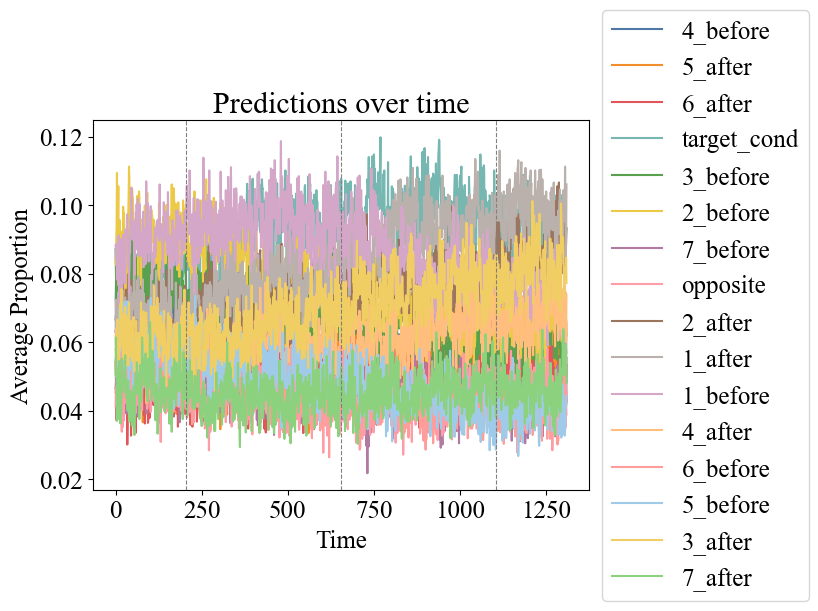

In [104]:
average_proportions_list = [average_proportionsList[0], average_proportionsList[1], average_proportionsList[2], average_proportionsList[3], average_proportionsList[4], average_proportionsList[5],
                            average_proportionsList[6], average_proportionsList[7]]

'''
average_proportions_list = [average_proportionsList[0], average_proportionsList[1], average_proportionsList[2], average_proportionsList[3], average_proportionsList[4], average_proportionsList[5],
                            average_proportionsList[6], average_proportionsList[8], average_proportionsList[9], average_proportionsList[10], average_proportionsList[11], average_proportionsList[12],
                            average_proportionsList[13], average_proportionsList[14], average_proportionsList[15]]
'''

combined_proportions = defaultdict(lambda: defaultdict(list))

for average_proportions in average_proportions_list:
    for time_point, predictions in average_proportions.items():
        for prediction, proportion in predictions.items():
            combined_proportions[time_point][prediction].append(proportion)

# Calculate overall average proportions
overall_average_proportions = defaultdict(dict)

for time_point, predictions in combined_proportions.items():
    for prediction, proportions in predictions.items():
        average_proportion = sum(proportions) / len(proportions)
        overall_average_proportions[time_point][prediction] = average_proportion

colors = [
    "#4E79A7", "#F28E2B", "#E15759", "#76B7B2",
    "#59A14F", "#EDC948", "#B07AA1", "#FF9DA7",
    "#9C755F", "#BAB0AC", "#D4A6C8", "#FFBE7D",
    "#FF9D9A", "#A0CBE8", "#F1CE63", "#8CD17D"
]
# Extract predictions and time points
time_points = sorted(overall_average_proportions.keys())
predictions = list(next(iter(overall_average_proportions.values())).keys())


# Parameters for vertical lines
if odds:
    start = 1196 - 450   # Starting position for the first vertical line
    step = 450       # Distance between each vertical line
    n_lines = 7    # Number of vertical lines to add
elif evens:
    start = 696    # Starting position for the first vertical line
    step = 450       # Distance between each vertical line
    n_lines = 7
else:
    start = 655 - 450   # Starting position for the first vertical line
    step = 450       # Distance between each vertical line
    n_lines = 3


print("Number of colors:", len(colors))
print("Number of predictions:", len(predictions))
print("Index i:", i)

print(len(predictions))
for i, prediction in enumerate(predictions):
    print(i)
    proportions = [overall_average_proportions[time_point][prediction] for time_point in time_points]
    plt.plot(time_points, proportions, label=prediction, color=colors[i])

#For prediction in predictions: <--- without enumerating over color list


# Add vertical lines
for i in range(n_lines):
    plt.axvline(x=start + i * step, color='grey', linestyle='--', linewidth=0.8)

plt.xlabel('Time')
plt.ylabel('Average Proportion')
plt.title('Predictions over time')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5)) 
plt.grid(False)
#plt.tight_layout()
plt.show()

In [151]:
print(overall_average_proportions[2259])

{'5_before': 0.08571428571428572, '1_before': 0.09183673469387754, '4_after': 0.07589285714285714, '7_before': 0.07142857142857142, '5_after': 0.06632653061224489, '1_after': 0.09375, 'opposite': 0.0510204081632653, '4_before': 0.07142857142857142, '2_before': 0.049107142857142856, '3_after': 0.11160714285714285, '3_before': 0.08571428571428572, '2_after': 0.04464285714285714, 'target_cond': 0.03571428571428571, '6_after': 0.08035714285714285, 'catch': 0.05, '7_after': 0.07142857142857142, '6_before': 0.059523809523809514}


In [149]:
for time_point in time_points:
    print(time_point)
    print(overall_average_proportions[time_point][prediction])

0
0.08928571428571429
1
0.08673469387755102
2
0.08571428571428572
3
0.10714285714285714
4
0.08928571428571429
5
0.06696428571428571
6
0.08928571428571429
7
0.07589285714285714
8
0.07142857142857142
9
0.07142857142857142
10
0.10714285714285714
11
0.06547619047619048
12
0.07142857142857142
13
0.0625
14
0.07142857142857142
15
0.08928571428571427
16
0.07857142857142857
17
0.07142857142857142
18
0.08928571428571429
19
0.07142857142857142
20
0.10714285714285715
21
0.07142857142857142
22
0.05
23
0.12142857142857141
24
0.10119047619047618
25
0.061224489795918366
26
0.05357142857142857
27
0.05
28
0.07142857142857142
29
0.09285714285714285
30
0.07857142857142857
31
0.07738095238095237
32
0.07738095238095237
33
0.07142857142857142
34
0.08673469387755102
35
0.09285714285714285
36
0.08928571428571429
37
0.05612244897959184
38
0.05
39
0.07142857142857142
40
0.07857142857142857
41
0.061224489795918366
42
0.09693877551020406
43
0.05357142857142857
44
0.059523809523809514
45
0.05714285714285714
46
0.05

KeyError: 'target_cond'

In [147]:
for i, prediction in enumerate(predictions):
    proportions = [overall_average_proportions[time_point][prediction] for time_point in time_points]
    print(i)
    print(prediction)

0
1_after
1
3_after


KeyError: 'target_cond'

In [141]:
print(len(overall_average_proportions))

3596


In [142]:
print(time_points[-1])

3595


In [146]:
print(overall_average_proportions[3595])

{'target_cond': 0.059523809523809514, '1_after': 0.10204081632653061, '2_before': 0.05612244897959184, 'opposite': 0.05803571428571428, '7_after': 0.08035714285714285, '7_before': 0.09375, '1_before': 0.08928571428571429, '3_after': 0.07653061224489796, '4_before': 0.06547619047619048, '6_before': 0.07857142857142857, '4_after': 0.059523809523809514, '5_after': 0.08333333333333333, 'catch': 0.03571428571428571, '3_before': 0.07653061224489796, '2_after': 0.08035714285714285, '6_after': 0.07142857142857142, '5_before': 0.09183673469387754}


In [ ]:
step1 = 440
step2 = 460
start_point = 600 - step2


x_vertical_lines = []
current_position = start_point

# Generate alternating pattern
#while current_position <= max(time_points) + max(step1, step2):
while current_position <= 3000 + max(step1, step2):
    x_vertical_lines.append(current_position)
    current_position += step1  # Add the first step
    x_vertical_lines.append(current_position)
    current_position += step2  # Add the second step

In [135]:
print((overall_average_proportions[0]))

{'1_after': 0.04642857142857142, '3_before': 0.07142857142857142, '1_before': 0.08095238095238094, '2_after': 0.05994897959183674, '6_before': 0.07015306122448979, '2_before': 0.09047619047619047, '6_after': 0.06593406593406594, '7_after': 0.05119047619047619, '3_after': 0.06887755102040817, 'target_cond': 0.075, '4_before': 0.055952380952380955, '4_after': 0.07015306122448979, '7_before': 0.04974489795918367, '5_after': 0.0625, '5_before': 0.061224489795918366, 'opposite': 0.0625}


##SLIDING TIME WINDOW##

In [158]:
print(decoding_dictList)

[{'0022_Left': [array(['0045', '0135', '0180', '0045', '0001', '0090', '0090'],
      dtype=object), array(['0090', '0135', '0045', '0045', '0315', '0135', '0090'],
      dtype=object), array(['0090', '0090', '0045', '0045', '0315', '0135', '0090'],
      dtype=object), array(['0001', '0225', '0045', '0045', '0001', '0135', '0135'],
      dtype=object), array(['0045', '0225', '0045', '0001', '0001', '0270', '0315'],
      dtype=object), array(['0045', '0225', '0045', '0001', '0045', '0135', '0090'],
      dtype=object), array(['0045', '0001', '0045', '0001', '0045', '0045', '0090'],
      dtype=object), array(['0315', '0225', '0045', '0090', '0045', '0045', '0090'],
      dtype=object), array(['0045', '0225', '0045', '0045', '0180', '0045', '0001'],
      dtype=object), array(['0270', '0225', '0045', '0045', '0180', '0090', '0090'],
      dtype=object), array(['0045', '0001', '0090', '0315', '0315', '0090', '0090'],
      dtype=object), array(['0045', '0001', '0090', '0001', '0045', '0

In [93]:
#Shifting time window of training times

trainStart = -0.2
increment = .01
trainEnd = trainStart + .04
print(trainEnd)
masterList = []
while trainEnd < .6:
    print('yes')
    decoding_dictList = []
    for i in result_list:
        decoding_dict = {}

        for movie, sample_time in i.items():
            x_train, x_test, y_train, y_test = train_test_split_cross(epochs_selected, epochs_stackedMovie, movie, trainStart, trainEnd)

            startTime = sample_time - 10
            endTime = sample_time + 10
            #decoding_list.append(Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(len(epochs_stackedMovie.times[startTime:endTime]))))
            decoding_list = Parallel(n_jobs=12, prefer="threads")(delayed(run_decoding_cross)(x_train,y_train,x_test[:,:,t]) for t in range(startTime, endTime))
            movie = movie
            decoding_dict[movie] = decoding_list
            print('movie is', movie)
            print('epo time is', startTime, endTime)
        decoding_dictList.append(decoding_dict)
    masterList.append(decoding_dictList)
    trainStart += increment
    trainEnd += increment


-0.16
yes
movie is 0022_Left
epo time is 686 706
movie is 0067_Left
epo time is 1586 1606
movie is 0112_Left
epo time is 2486 2506
movie is 0157_Left
epo time is 3386 3406
movie is 0202_Right
epo time is 3406 3426
movie is 0247_Right
epo time is 2506 2526
movie is 0292_Right
epo time is 1606 1626
movie is 0337_Right
epo time is 706 726
movie is 0067_Left
epo time is 1146 1166
movie is 0112_Left
epo time is 2046 2066
movie is 0157_Left
epo time is 2946 2966
movie is 0247_Right
epo time is 2946 2966
movie is 0292_Right
epo time is 2046 2066
movie is 0337_Right
epo time is 1146 1166
movie is 0022_Right
epo time is 706 726
movie is 0067_Left
epo time is 686 706
movie is 0112_Left
epo time is 1586 1606
movie is 0157_Left
epo time is 2486 2506
movie is 0202_Left
epo time is 3386 3406
movie is 0247_Right
epo time is 3406 3426
movie is 0292_Right
epo time is 2506 2526
movie is 0337_Right
epo time is 1606 1626
movie is 0022_Right
epo time is 1146 1166
movie is 0112_Left
epo time is 1146 1166
mo

In [95]:

#Function takes in a a list of decoding dictionaries, each dictionary maps a particular movie condition to a set of predictions over time
#Here we are collapsing across time and asking how many times a given still condition is predicted relative to all other predictions
#It is assumed that the order of the list matches the order of ordered_conditions, so for instance the first set of dictionaries in the list
#should contain movies where 'center' is the target prediciton, and so we look at the proportion of times 'center' was predicted relative
#to all other predictions
ordered_conditions = ['0001', '0045', '0090', '0135', '0180', '0225', '0270', '0315']
ordered_conditions = ['0001', '0022', '0045', '0067', '0090', '0112', '0135', '0157', '0180', '0202', '0225', '0247', '0270', '0292', '0315', '0337']

def getAveragePrediction(decoding_dictList, ordered_conditions):
    proportionList = []
    for index, cond in enumerate(ordered_conditions):
        all_strings = [item for sublist in decoding_dictList[index].values() for item in sublist]
        flattened_list = [item for array in all_strings for item in array]
        center_count = flattened_list.count(cond)
        total_entries = len(flattened_list)
        proportion = center_count / total_entries
        proportionList.append(proportion)
    values_array = np.array(proportionList)
    return np.mean(values_array)


In [96]:
decoding_peak = []
for i in masterList:
    decoding_peak.append(getAveragePrediction(i, ordered_conditions))

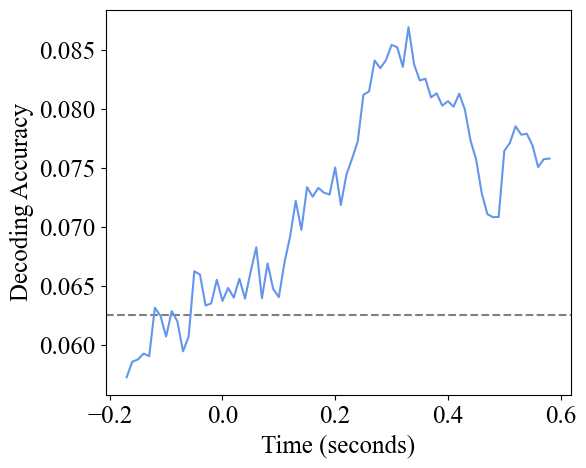

In [97]:
# Generate the time values
start_time = -.17
time_increment = .01
time_values = [start_time + i * time_increment for i in range(len(masterList))]
plt.rcParams['font.size'] = 18
plt.rcParams['font.family'] = 'Times New Roman'
# Create the plot
plt.figure(figsize=(6, 5))
plt.axhline(y=1/16, color='grey', linestyle='--', label='chance')
plt.plot(time_values, decoding_peak, color = '#6495ED')

# Add labels and title
plt.xlabel('Time (seconds)')
plt.ylabel('Decoding Accuracy')


# Display the plot
plt.show()